# **Environment Set-Up**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
pip install --quiet --upgrade tensorflow-federated

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.6/70.6 MB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 721.6/721.6 kB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.7/73.7 MB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 33.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 66.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.7/33.7 MB 31.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 257.7/257.7 kB 26.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 241.2/241.2 kB 23.0 MB/s eta 0:00:00
     ━━━━━━━

In [3]:
#Tensorboard extension import
%load_ext tensorboard

# **Import required libraries**

In [ ]:
!pip install --upgrade numpy
#!pip uninstall numpy
#!pip install numpy


  Using cached numpy-1.26.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.2 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.25.2
    Uninstalling numpy-1.25.2:
      Successfully uninstalled numpy-1.25.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
cupy-cuda11x 11.0.0 requires numpy<1.26,>=1.20, but you have numpy 1.26.2 which is incompatible.
flax 0.7.5 requires jax>=0.4.19, but you have jax 0.4.14 which is incompatible.
scipy 1.9.3 requires numpy<1.26.0,>=1.18.5, but you have numpy 1.26.2 which is incompatible.


In [ ]:
!pip install tensorflow_federated

  Using cached numpy-1.25.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.2 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.2
    Uninstalling numpy-1.26.2:
      Successfully uninstalled numpy-1.26.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
flax 0.7.5 requires jax>=0.4.19, but you have jax 0.4.14 which is incompatible.


In [ ]:
import numpy as np
import tensorflow as tf
import tensorflow_federated as tff
import collections
import random
from tensorflow import keras
from tensorflow.keras import layers
import pickle
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt

# **Import Dataset**

In [ ]:
train_dir = ('/content/drive/MyDrive/flower/training')
NUM_CLASSES = 4
BATCH_SIZE = 32
IMG_SIZE = (160, 160)
IMG_SHAPE = IMG_SIZE + (3,) # 3 specifies no of channel in the image.

Larger batch size trained the model faster but it requires more hardware/memory .

# **Define Mapping fn**

In [ ]:
# Creating a map function to preprocess a dataset
def map_fn(image_batch,labels_batch):return collections.OrderedDict(x=image_batch,y=labels_batch)
flower_clients_ids = range(100)

# creating a training dataset for a specific client
def create_client_dataset_fn(str):
    train_dataset = tf.keras.preprocessing.image_dataset_from_directory(train_dir,
                                                                        shuffle=True,
                                                                        seed=int(str),
                                                                        validation_split=0.8,
                                                                        subset="training",
                                                                        image_size=IMG_SIZE,
                                                                        batch_size=BATCH_SIZE)
    return train_dataset.map(map_fn).prefetch(tf.data.experimental.AUTOTUNE)

In [ ]:
# flower_clients_dataset = tff.simulation.ClientData.from_clients_and_fn(flower_clients_ids,create_client_dataset_fn)

In [ ]:
# Creating federate dataset using tenserflow federate
flower_clients_dataset = tff.simulation.datasets.TestClientData.from_clients_and_tf_fn(flower_clients_ids,create_client_dataset_fn)

Found 480 files belonging to 4 classes.
Using 96 files for training.


# **Get random data from dataset**

In [ ]:
def make_random_federated_data(client_data, num_clients):
    random_clientids = random.sample(client_data.client_ids, num_clients)
    return [
        client_data.create_tf_dataset_for_client(x)
        for x in random_clientids
    ]
flower_sample = make_random_federated_data(flower_clients_dataset,10)
input_spec = flower_sample[0].element_spec

Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.


# **Create Model and its functions**

In [ ]:
# This function defines a simple convolutional neural network (CNN) using TensorFlow Keras.
def create_keras_model():
    model = tf.keras.models.Sequential([
        tf.keras.layers.experimental.preprocessing.Rescaling(1. / 255, input_shape=IMG_SHAPE),
        tf.keras.layers.Conv2D(16, 3, padding='same', activation='relu'),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu'),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dense(NUM_CLASSES)])
    return model

In [ ]:
def model_fn():
  keras_model = create_keras_model()
  return tff.learning.models.from_keras_model(
      keras_model,
      input_spec=input_spec,
      loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
      metrics=[tf.keras.metrics.SparseCategoricalAccuracy()]
  )

In [ ]:
fed_avg = tff.learning.algorithms.build_weighted_fed_avg(
    model_fn,
    client_optimizer_fn=lambda:tf.keras.optimizers.Adam(),
    server_optimizer_fn=lambda:tf.keras.optimizers.Adam(),
    use_experimental_simulation_loop = True
)

In [ ]:
print(dir(fed_avg))

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_get_hparams_fn', '_get_model_weights', '_initialize_fn', '_next_fn', '_set_hparams_fn', '_set_model_weights', '_state_type', 'get_hparams', 'get_model_weights', 'initialize', 'next', 'set_hparams', 'set_model_weights', 'state_type']


# **Train Model**

In [ ]:
state = fed_avg.initialize()
NUM_ROUNDS = 40
all_metrics = []
participating_clients_per_round = [] #.....

for round_num in range(1, NUM_ROUNDS):
    print("in FL training!")

    # Get a random subset of clients for this round
    selected_clients = make_random_federated_data(flower_clients_dataset, 10) #.....

    # Store the number of participating clients in this round
    participating_clients_per_round.append(len(selected_clients)) #.....

    state, metrics = fed_avg.next(state, make_random_federated_data(flower_clients_dataset,10))
    #state, metrics = fed_avg.next(state, selected_clients) #..........
    print('round {:2d}, metrics={}'.format(round_num, metrics))
    all_metrics.append(metrics)

# Plot the client participation curve
plt.figure(figsize=(8, 5)) #.....
plt.plot(range(1, NUM_ROUNDS), participating_clients_per_round, marker='o', linestyle='-') #....
plt.title('Client Participation Curve') #.......
plt.xlabel('Communication Round') #.......
plt.ylabel('Number of Participating Clients') #.......
plt.show() #......

fed_avg_model = create_keras_model()
fed_avg.get_model_weights(state)
# state.model.assign_weights_to(fed_avg_model)
fed_avg_model.save('fed_avg_model.h5')

f= open('all_metrics.pkl', 'wb')
pickle.dump(all_metrics, f)
f.close()


in FL training!
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files belonging to 4 classes.
Using 96 files for training.
Found 480 files be

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


#**Print Result**

In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import numpy as np


# Load and preprocess the testing data
def map_fn(image_batch,labels_batch):return collections.OrderedDict(x=image_batch,y=labels_batch)
flower_clients_ids = range(100)

test_dir = ('/content/drive/MyDrive/flower/testing')

# def create_testing_dataset():
#     test_dataset = tf.keras.preprocessing.image_dataset_from_directory(
#         test_dir,
#         image_size=IMG_SIZE,
#         batch_size=BATCH_SIZE
#     )
#     return test_dataset.map(map_fn).prefetch(tf.data.experimental.AUTOTUNE)

def create_testing_dataset():
    test_dataset = tf.keras.preprocessing.image_dataset_from_directory(
        test_dir,
        image_size=IMG_SIZE,
        batch_size=BATCH_SIZE
    )


    def map_fn(image_batch, labels_batch):
        # Apply rescaling here, matching the preprocessing in the training data
        image_batch = image_batch / 255.0
        return collections.OrderedDict(x=image_batch, y=labels_batch)

    return test_dataset.map(map_fn).prefetch(tf.data.experimental.AUTOTUNE)

testing_dataset = create_testing_dataset()

# Load the saved Keras model, which includes preprocessing layers
# keras_model = tf.keras.models.load_model('/content/fed_avg_model.h5')

# Compile the Keras model
keras_model = keras.models.load_model('/content/fed_avg_model.h5')

Found 120 files belonging to 4 classes.


In [ ]:
# Compile the loaded model
keras_model.compile(
    optimizer=tf.keras.optimizers.Adam(),  # Replace with your desired optimizer
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=[tf.keras.metrics.SparseCategoricalAccuracy()]
)

In [ ]:
# Create a list to store true labels and predicted labels
true_labels = []
predicted_labels = []

# Iterate through the federated data for evaluation
for client_dataset in flower_sample:
    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = keras_model.predict(images)
        predicted_labels.extend(np.argmax(predictions, axis=1))
        true_labels.extend(labels)

1/1 [==============================] - 0s 199ms/step


In [ ]:
# Calculate and print precision, recall, and F1 score
precision = precision_score(true_labels, predicted_labels, average='macro', zero_division=0)
recall = recall_score(true_labels, predicted_labels, average='macro', zero_division=0)
f1 = f1_score(true_labels, predicted_labels, average='macro')

# Print or store the evaluation metrics
# print(f"Accuracy: {testing_results[1]}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

Precision: 0.06015625
Recall: 0.25
F1 Score: 0.09697732997481108


In [ ]:
# Calculate confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels)
print(confusion)

[[  0   0 261   0]
 [  0   0 231   0]
 [  0   0 231   0]
 [  0   0 237   0]]


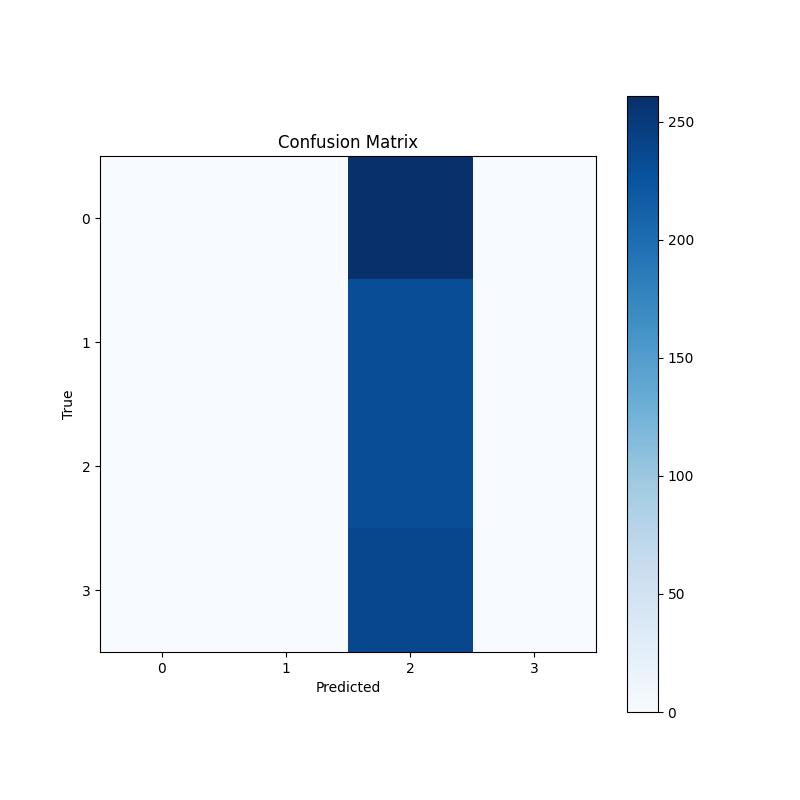

In [ ]:
# Visualize and save the confusion matrix
plt.figure(figsize=(8, 8))
plt.imshow(confusion, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xticks(np.arange(NUM_CLASSES))
plt.yticks(np.arange(NUM_CLASSES))
plt.xlabel('Predicted')
plt.ylabel('True')
plt.savefig('Confusion_Matrix.jpg')  # Save the confusion matrix to a file

# Optionally, display the saved image using the IPython display function
from IPython.display import Image
Image(filename='Confusion_Matrix.jpg')


In [ ]:
# Select a random federated dataset client
client_dataset = random.choice(flower_sample)

# Select a random image from the client's dataset
sample_batch = next(iter(client_dataset))
sample_image = sample_batch['x'][0]  # Assuming you want to display the first image in the batch

# Make predictions using the loaded model
predictions = keras_model.predict(sample_image[np.newaxis])

# Get the predicted class label
predicted_label = np.argmax(predictions)

# Display the image and the predicted class label
plt.figure()
plt.imshow(sample_image)
plt.title(f'Predicted Class: {predicted_label}')
plt.show()


1/1 [==============================] - 0s 97ms/step


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Display images for a client (assuming this is within a loop)
for batch in client_dataset:
    images = batch['x']
    labels = batch['y']

    # Clip pixel values to the valid range for imshow
    images = np.clip(images.numpy(), 0.0, 1.0)  # Assuming images are in [0.0, 1.0] range

    # Display each image in the batch
    for i in range(images.shape[0]):
        plt.figure()
        plt.imshow(images[i])
        plt.title(f"Label: {labels[i].numpy()}")
        plt.show()


<ipython-input-19-e6856012ddef>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


## (Macro and Micro) Precision, Recall and F1 Score Visualization

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
import matplotlib.pyplot as plt
from IPython.display import Image, display


In [ ]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import precision_recall_curve

# Convert true labels to a binary format (one-hot encoding)
true_labels_binary = label_binarize(true_labels, classes=range(NUM_CLASSES))

# Create empty lists to store precision, recall, and f1 scores for each class
precision_per_class = []
recall_per_class = []
f1_per_class = []

# Iterate over each class and calculate precision, recall, and f1 scores
for class_idx in range(NUM_CLASSES):
    precision, recall, _ = precision_recall_curve(true_labels_binary[:, class_idx], predicted_labels, pos_label=1)
    f1_scores = 2 * (precision * recall) / (precision + recall)

    precision_per_class.append(precision)
    recall_per_class.append(recall)
    f1_per_class.append(f1_scores)

# Now you have precision, recall, and F1 scores for each class.
# You can plot these curves individually or aggregate them as needed.


In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score

# Calculate micro-averaged scores
micro_precision = precision_score(true_labels, predicted_labels, average='micro', zero_division=0)
micro_recall = recall_score(true_labels, predicted_labels, average='micro', zero_division=0)
micro_f1 = f1_score(true_labels, predicted_labels, average='micro')

# Calculate macro-averaged scores
macro_precision = precision_score(true_labels, predicted_labels, average='macro', zero_division=0)
macro_recall = recall_score(true_labels, predicted_labels, average='macro', zero_division=0)
macro_f1 = f1_score(true_labels, predicted_labels, average='macro')

# Print the micro-averaged scores
print(f"Micro-Averaged Precision: {micro_precision}")
print(f"Micro-Averaged Recall: {micro_recall}")
print(f"Micro-Averaged F1 Score: {micro_f1}")

print( )
# Print the macro-averaged scores
print(f"Macro-Averaged Precision: {macro_precision}")
print(f"Macro-Averaged Recall: {macro_recall}")
print(f"Macro-Averaged F1 Score: {macro_f1}")


Micro-Averaged Precision: 0.240625
Micro-Averaged Recall: 0.240625
Micro-Averaged F1 Score: 0.24062500000000003

Macro-Averaged Precision: 0.06015625
Macro-Averaged Recall: 0.25
Macro-Averaged F1 Score: 0.09697732997481108


Macro Precision: 0.06015625
Macro Recall: 0.25
Macro F1 Score: 0.09697732997481108


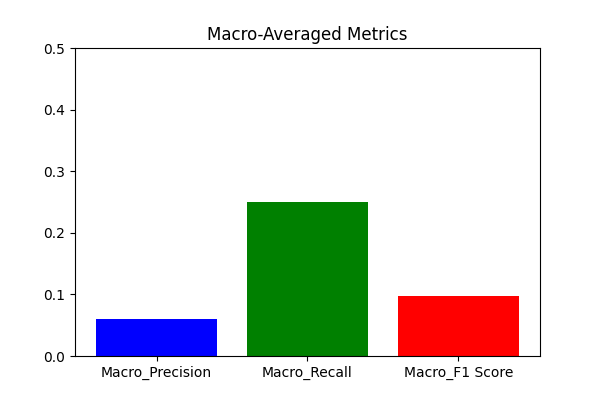

In [ ]:
# Convert lists to numpy arrays for sklearn metrics
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Calculate macro-averaged scores
macro_precision = precision_score(true_labels, predicted_labels, average='macro', zero_division=0)
macro_recall = recall_score(true_labels, predicted_labels, average='macro', zero_division=0)
macro_f1 = f1_score(true_labels, predicted_labels, average='macro')

# Create labels for the metrics
macro_metrics = ['Macro_Precision', 'Macro_Recall', 'Macro_F1 Score']

# Create a list of the macro-averaged values
macro_values = [macro_precision, macro_recall, macro_f1]

# Check the values
print("Macro Precision:", macro_precision)
print("Macro Recall:", macro_recall)
print("Macro F1 Score:", macro_f1)

# Set a larger figure size to increase x-axis label width
plt.figure(figsize=(6, 4))

# Plot a bar chart for macro-averaged metrics
plt.bar(macro_metrics, macro_values, color=['blue', 'green', 'red'])
plt.ylim([0.0, 0.5])  # Set y-axis limit between 0 and 1 for better visibility
#plt.xlim([0.0, 5.0])
plt.title("Macro-Averaged Metrics")

# Save the plot as an image file (e.g., PNG)
plt.savefig('macro_averaged_metrics.png')

# Display the saved image using Colab's display function
display(Image(filename='macro_averaged_metrics.png'))


Micro Precision: 0.240625
Micro Recall: 0.240625
Micro F1 Score: 0.24062500000000003


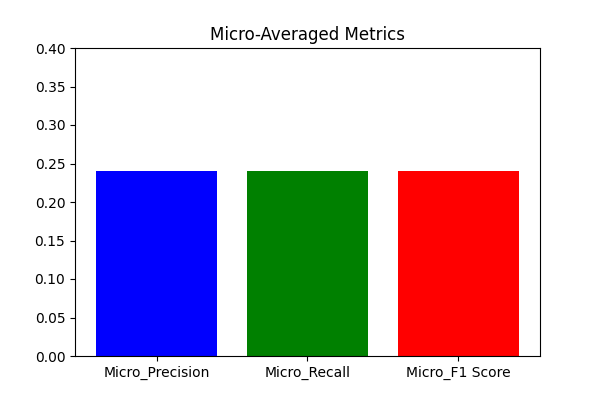

In [ ]:
# Convert lists to numpy arrays for sklearn metrics
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Calculate micro-averaged scores
micro_precision = precision_score(true_labels, predicted_labels, average='micro', zero_division=0)
micro_recall = recall_score(true_labels, predicted_labels, average='micro', zero_division=0)
micro_f1 = f1_score(true_labels, predicted_labels, average='micro')

# Create labels for the metrics
micro_metrics = ['Micro_Precision', 'Micro_Recall', 'Micro_F1 Score']

# Create a list of the micro-averaged values
micro_values = [micro_precision, micro_recall, micro_f1]

# Check the values
print("Micro Precision:", micro_precision)
print("Micro Recall:", micro_recall)
print("Micro F1 Score:", micro_f1)

# Set a larger figure size to increase x-axis label width
plt.figure(figsize=(6, 4))

# Plot a bar chart for micro-averaged metrics
plt.bar(micro_metrics, micro_values, color=['blue', 'green', 'red'])
plt.ylim([0.0, 0.4])  # Set y-axis limit between 0 and 1 for better visibility
plt.title("Micro-Averaged Metrics")

# Save the plot as an image file (e.g., PNG)
plt.savefig('micro_averaged_metrics.png')

# Display the saved image using Colab's display function
display(Image(filename='micro_averaged_metrics.png'))


## **Image Classification at Each Client device**

In [ ]:
!pip install --upgrade matplotlib numpy


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 63.3 MB/s eta 0:00:00
  Using cached numpy-1.26.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.2 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.25.2
    Uninstalling numpy-1.25.2:
      Successfully uninstalled numpy-1.25.2
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.7.1
    Uninstalling matplotlib-3.7.1:
      Successfully uninstalled matplotlib-3.7.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
cupy-cuda11x 11.0.0 requires numpy<1.26,>=1.20, but you have numpy 1.26.2 which is incompatible.
flax 0

In [ ]:
# @title Default title text
!pip install scipy==1.5.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 25.2/25.2 MB 16.9 MB/s eta 0:00:00


In [ ]:
%matplotlib inline

In [ ]:
import random

In [ ]:
import tensorflow as tf
import numpy as np
# Define the model architecture
loaded_model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(160, 160, 3)),  # Input shape matching your image size
    tf.keras.layers.Rescaling(1. / 255),
    tf.keras.layers.Conv2D(16, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(NUM_CLASSES)
])


In [ ]:
# Load the trained model from a file
loaded_model = tf.keras.models.load_model('/content/fed_avg_model.h5')


In [ ]:
flower_clients_ids = range(10)

In [ ]:
# Create a list of 6 random client IDs for decentralized devices
random_client_ids = random.sample(flower_clients_ids, 6)

In [ ]:
# Create a list to store true labels and predicted labels for each client
true_labels_per_client = {}
predicted_labels_per_client = {}

In [ ]:
# Iterate through the selected client IDs
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)
    true_labels_per_client[client_id] = []
    predicted_labels_per_client[client_id] = []

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = keras_model.predict(images)
        predicted_labels_per_client[client_id].extend(np.argmax(predictions, axis=1))
        true_labels_per_client[client_id].extend(labels)

# Image classification at random client device

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 185ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 201ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 217ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 191ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 351ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 420ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 1s 605ms/step


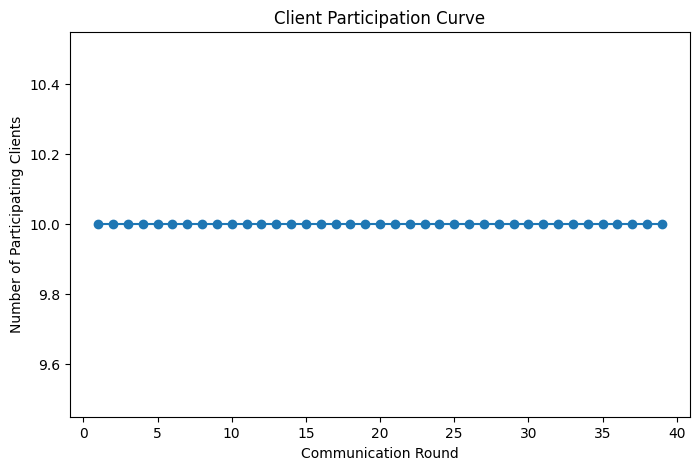

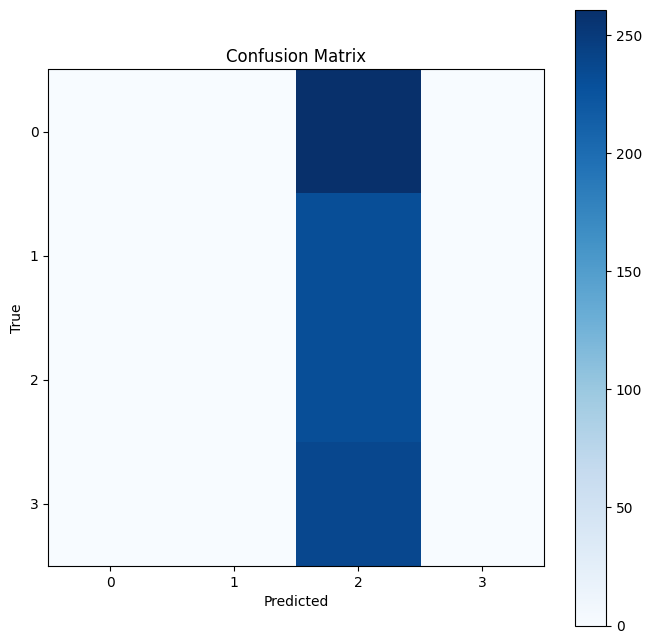

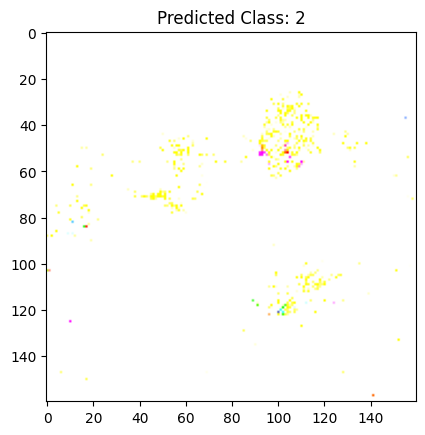

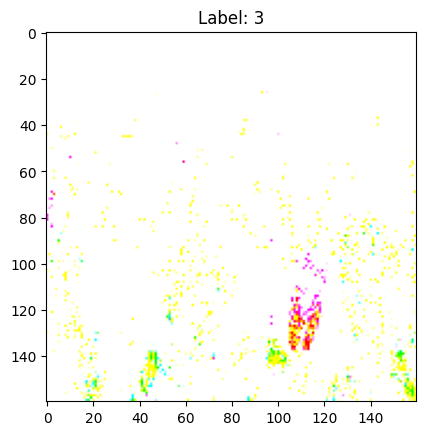

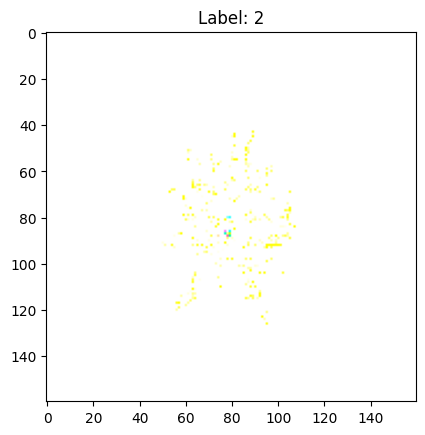

...

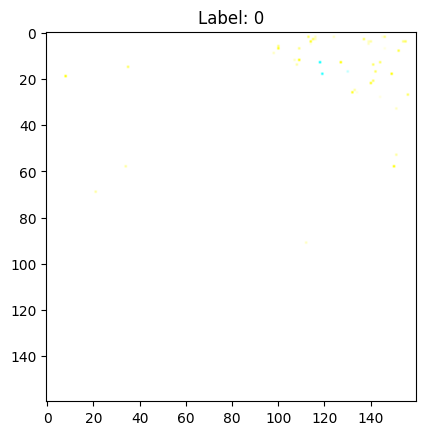

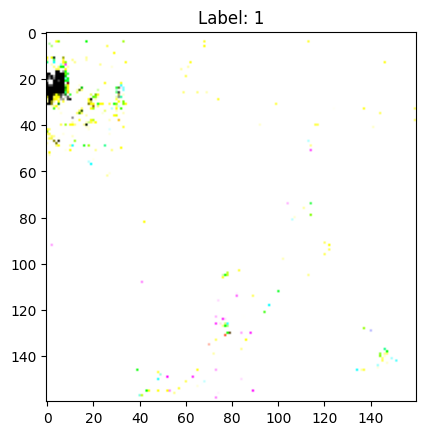

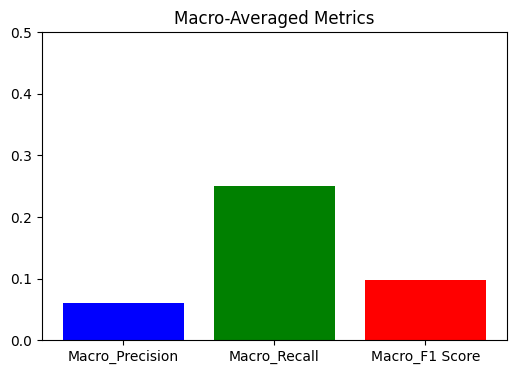

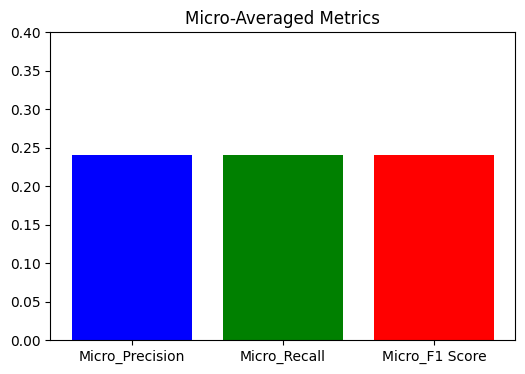

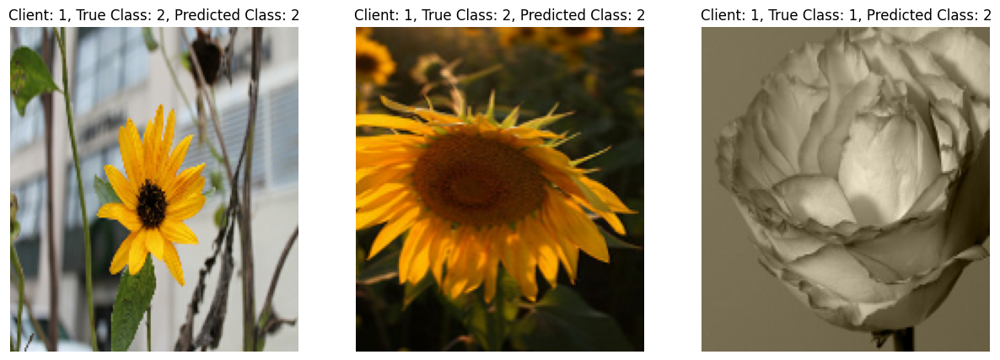

1/1 [==============================] - 0s 440ms/step


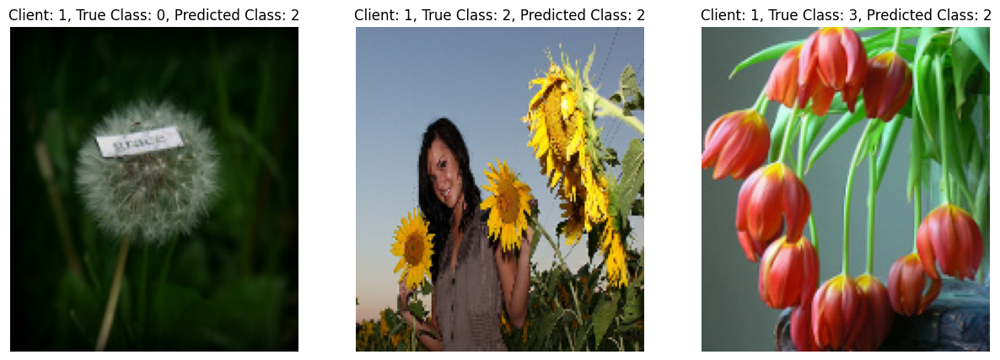

1/1 [==============================] - 0s 379ms/step


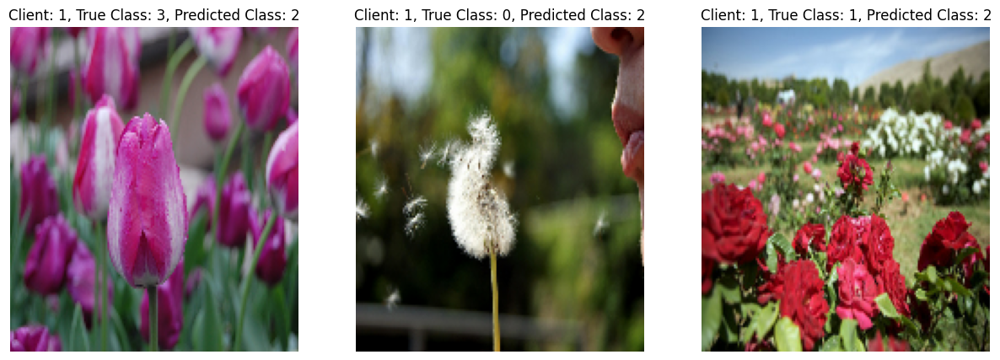

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 375ms/step


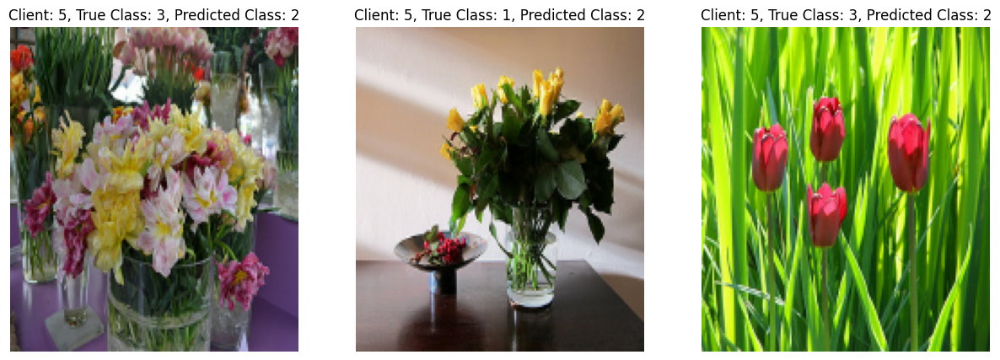

1/1 [==============================] - 0s 405ms/step


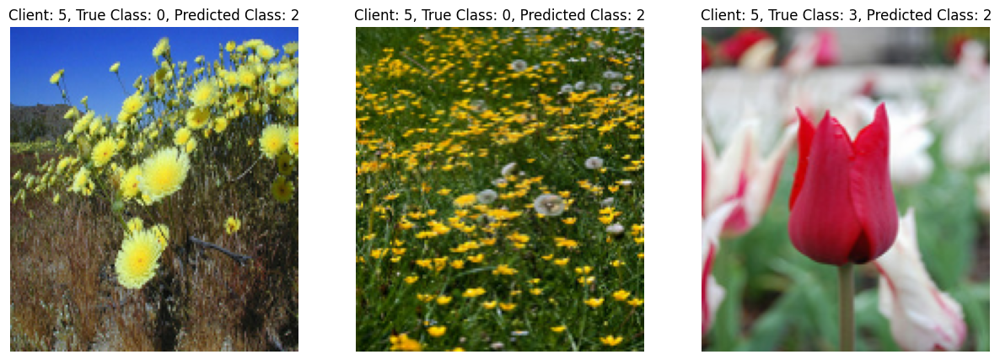

1/1 [==============================] - 0s 419ms/step


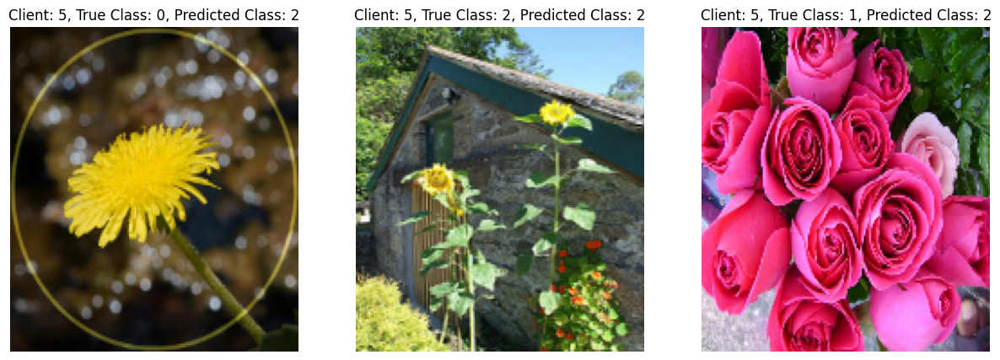

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 381ms/step


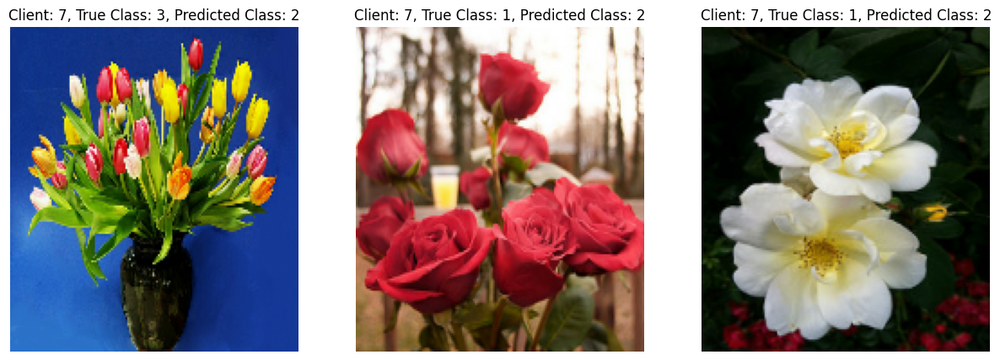

1/1 [==============================] - 0s 441ms/step


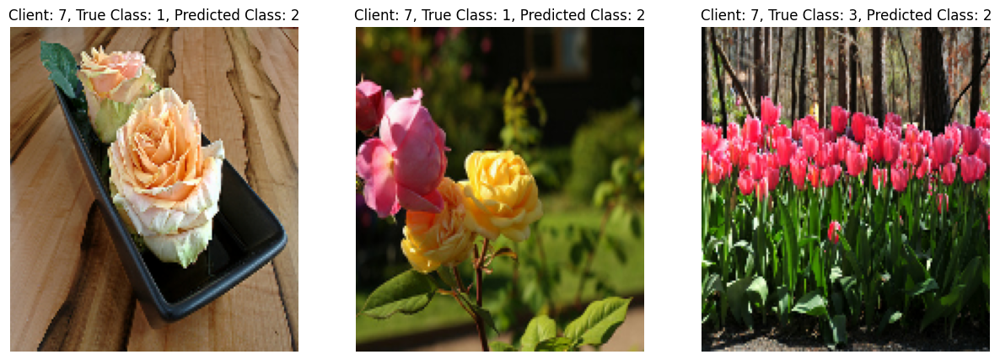

1/1 [==============================] - 0s 472ms/step


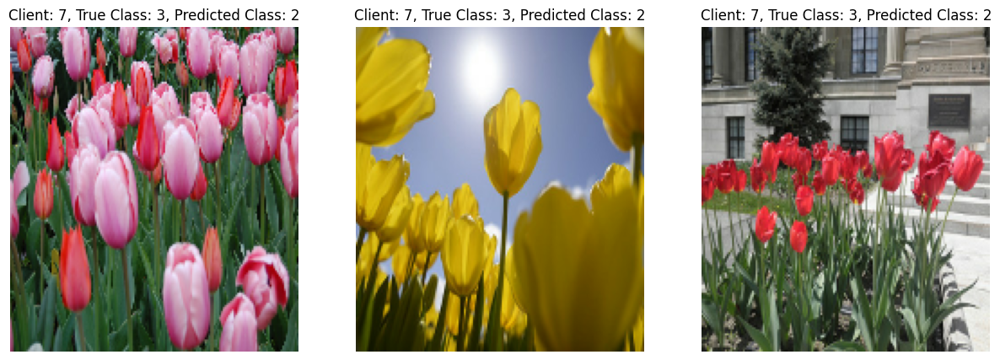

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 376ms/step


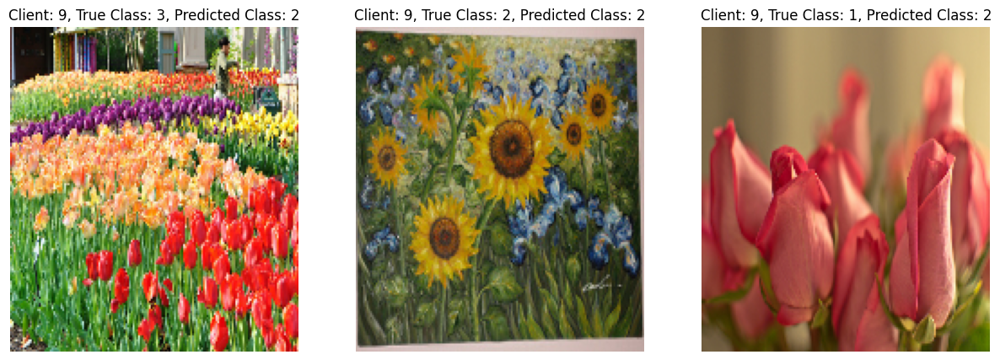

1/1 [==============================] - 0s 487ms/step


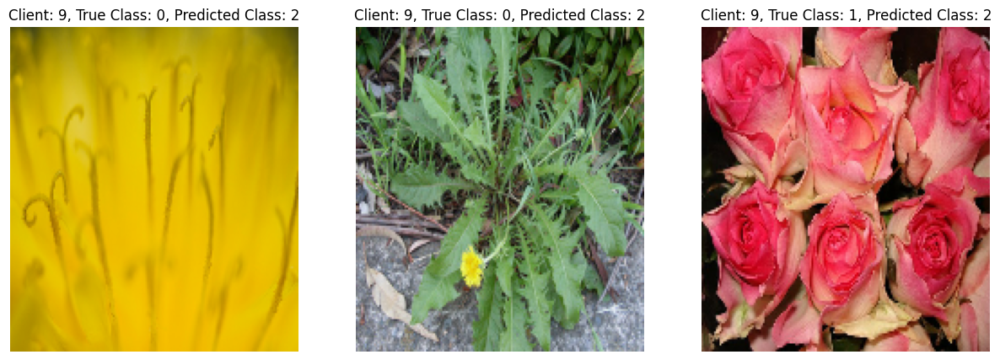

1/1 [==============================] - 0s 458ms/step


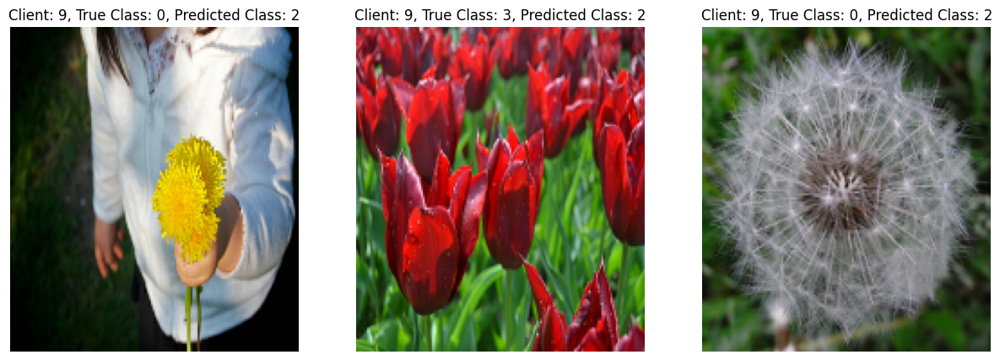

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 215ms/step


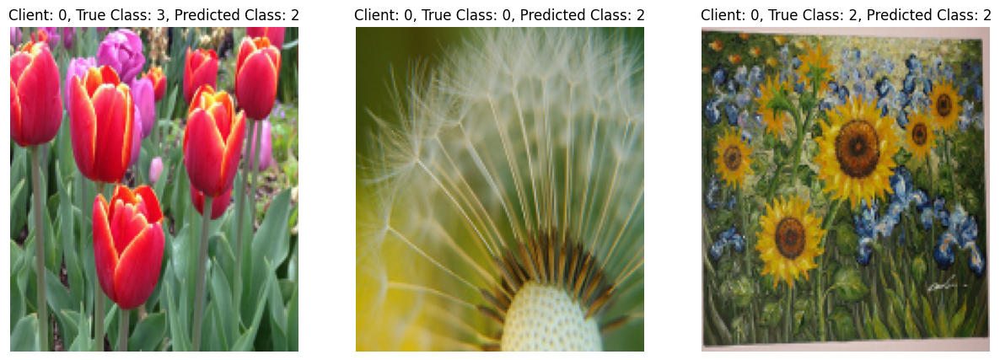

1/1 [==============================] - 0s 364ms/step


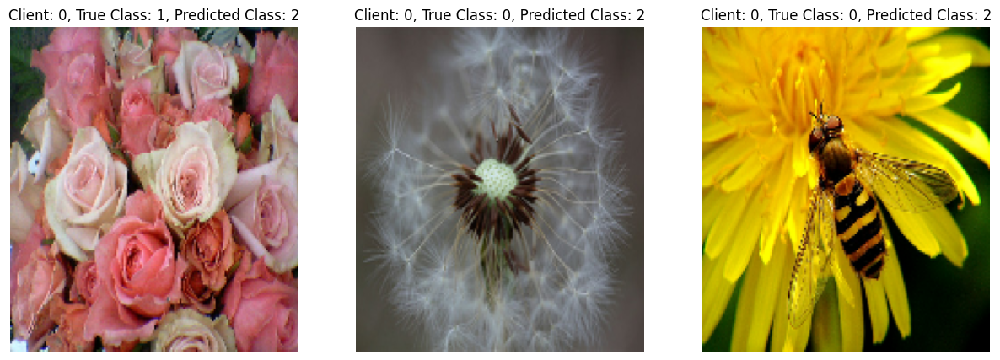

1/1 [==============================] - 0s 356ms/step


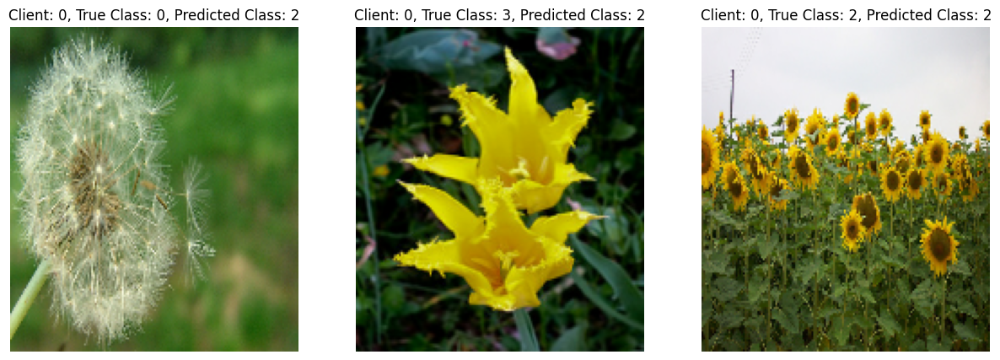

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 368ms/step


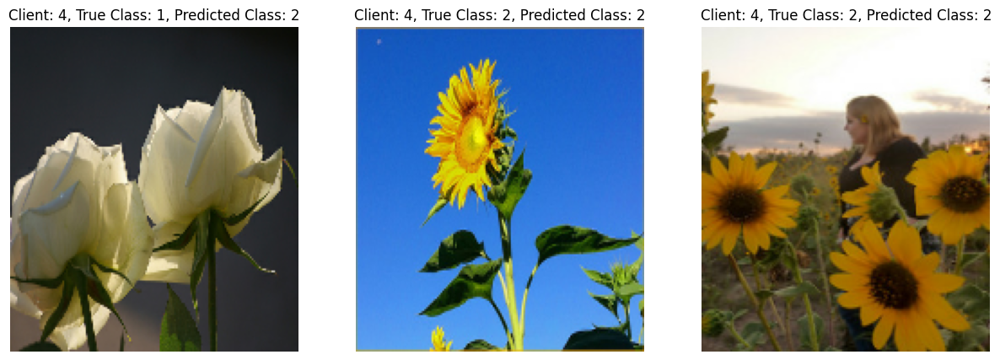

1/1 [==============================] - 0s 360ms/step


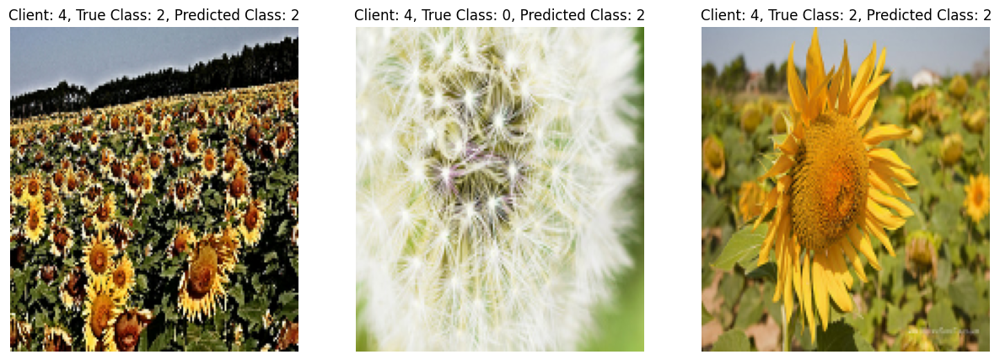

1/1 [==============================] - 0s 449ms/step


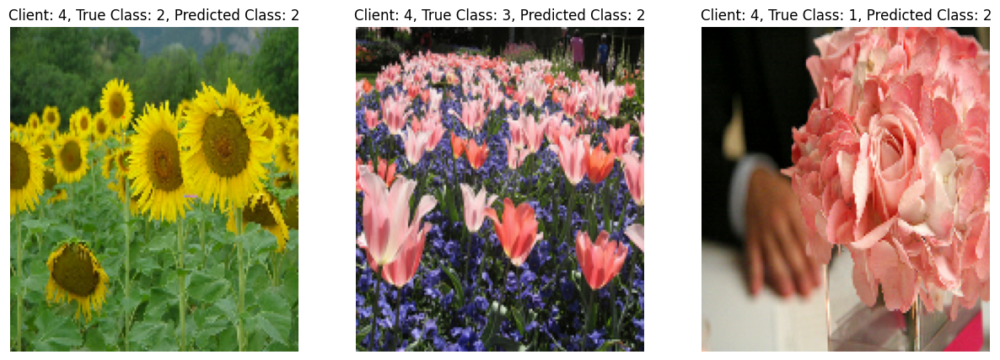

In [ ]:
import random
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# Iterate through the selected client IDs
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)
    true_labels_per_client[client_id] = []
    predicted_labels_per_client[client_id] = []

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = loaded_model.predict(images)
        predicted_labels_per_client[client_id].extend(np.argmax(predictions, axis=1))
        true_labels_per_client[client_id].extend(labels)

# Display a few images along with true and predicted labels
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = loaded_model.predict(images)
        predicted_labels = np.argmax(predictions, axis=1)

        num_images_to_display = min(3, len(images))
        plt.figure(figsize=(15, 5))  # Adjust the figure size as needed

        for i in range(num_images_to_display):
            plt.subplot(1, num_images_to_display, i+1)
            image = images[i].numpy() / 255.0
            plt.imshow(image, aspect='auto')  # Maintain aspect ratio
            true_label = labels[i].numpy()
            predicted_label = predicted_labels[i]
            plt.title(f'Client: {client_id}, True Class: {true_label}, Predicted Class: {predicted_label}')
            plt.axis('off')

        plt.show()


# Histogram of Classified images

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 353ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 408ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 363ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 372ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 369ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 368ms/step
Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 201ms/step


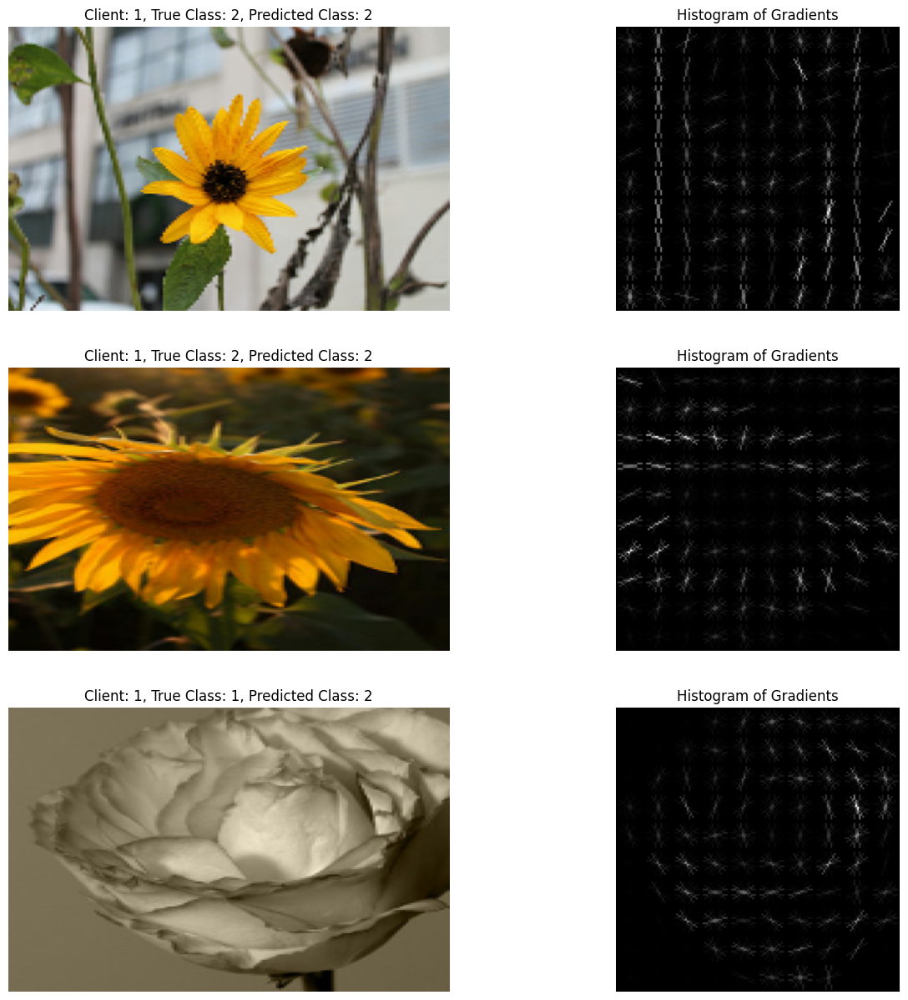

1/1 [==============================] - 0s 303ms/step


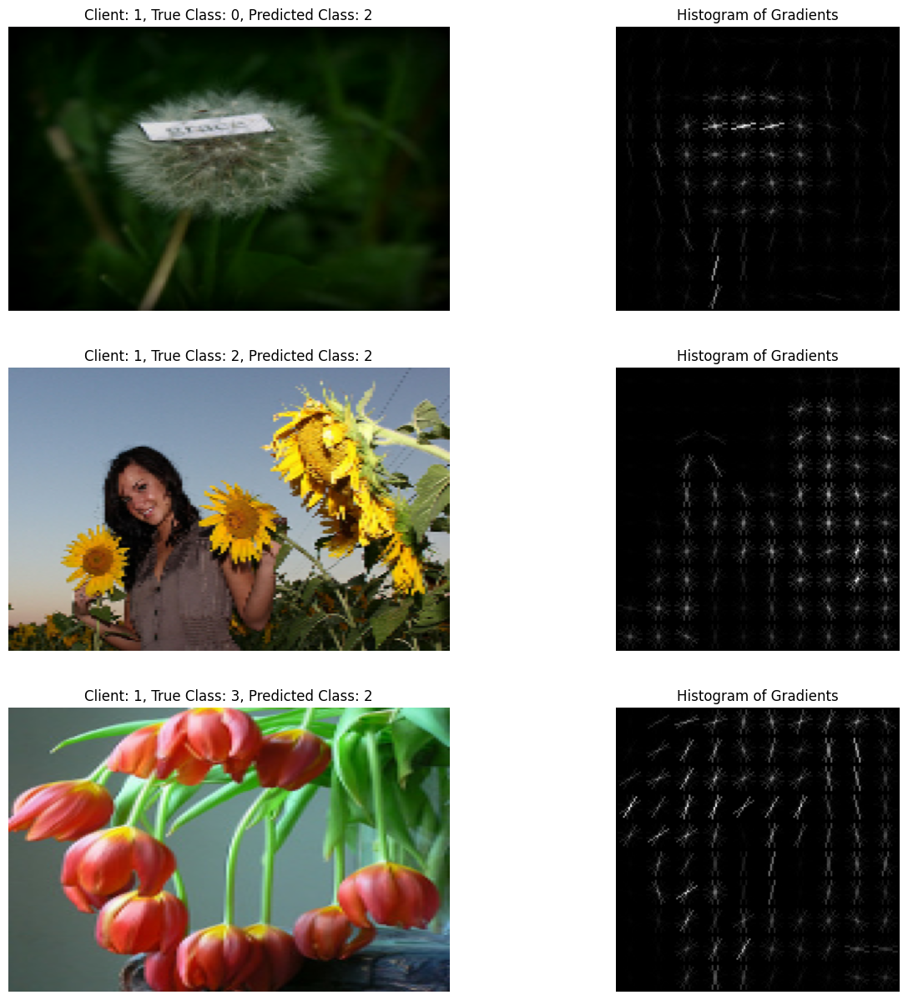

1/1 [==============================] - 0s 287ms/step


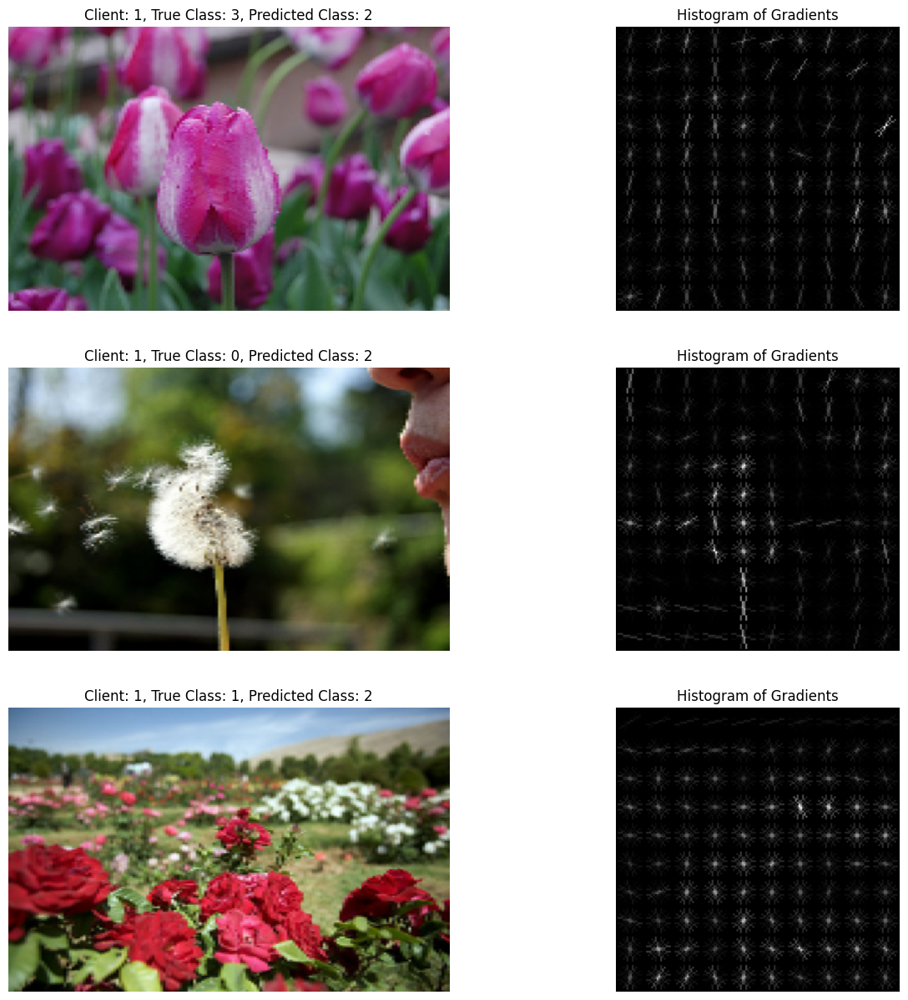

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 216ms/step


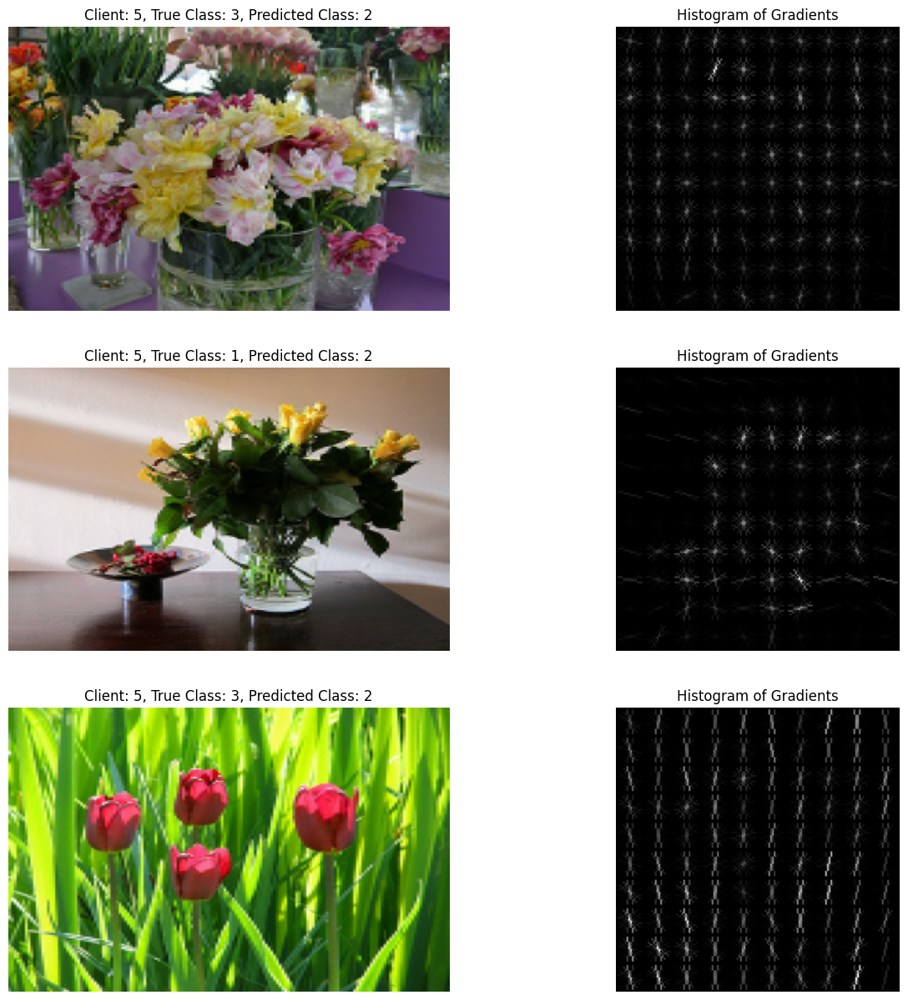

1/1 [==============================] - 0s 326ms/step


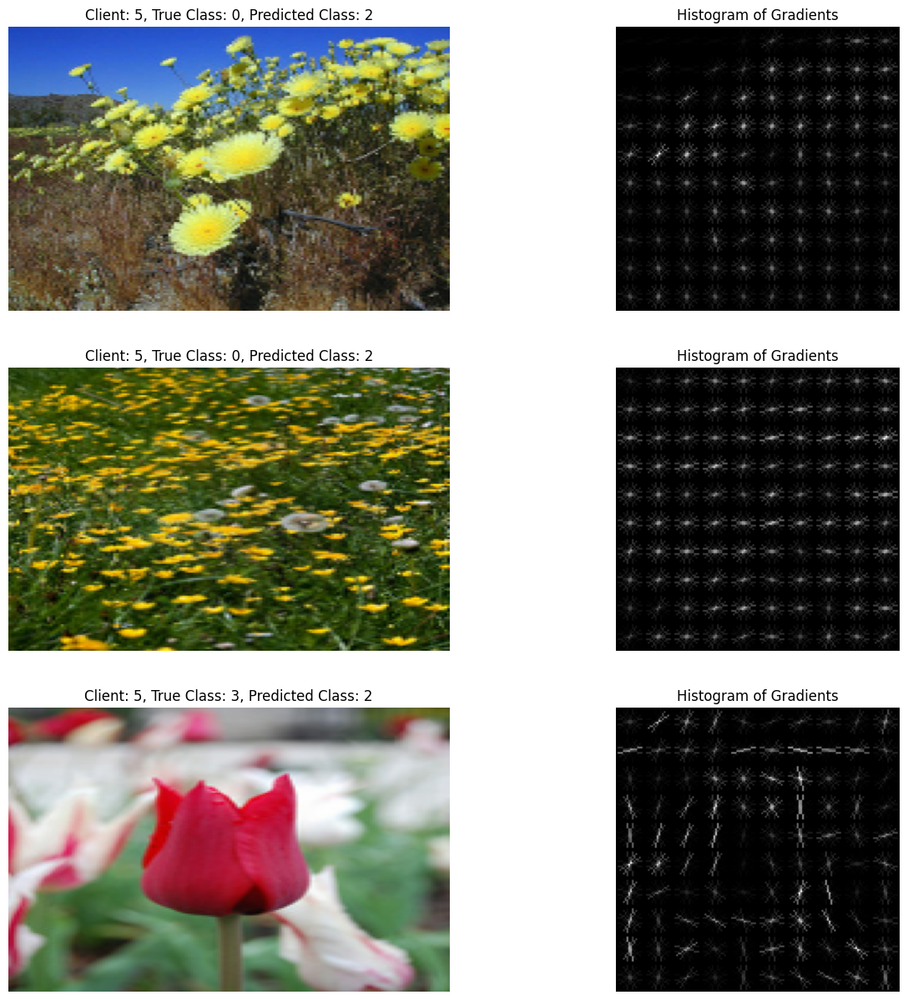

1/1 [==============================] - 0s 398ms/step


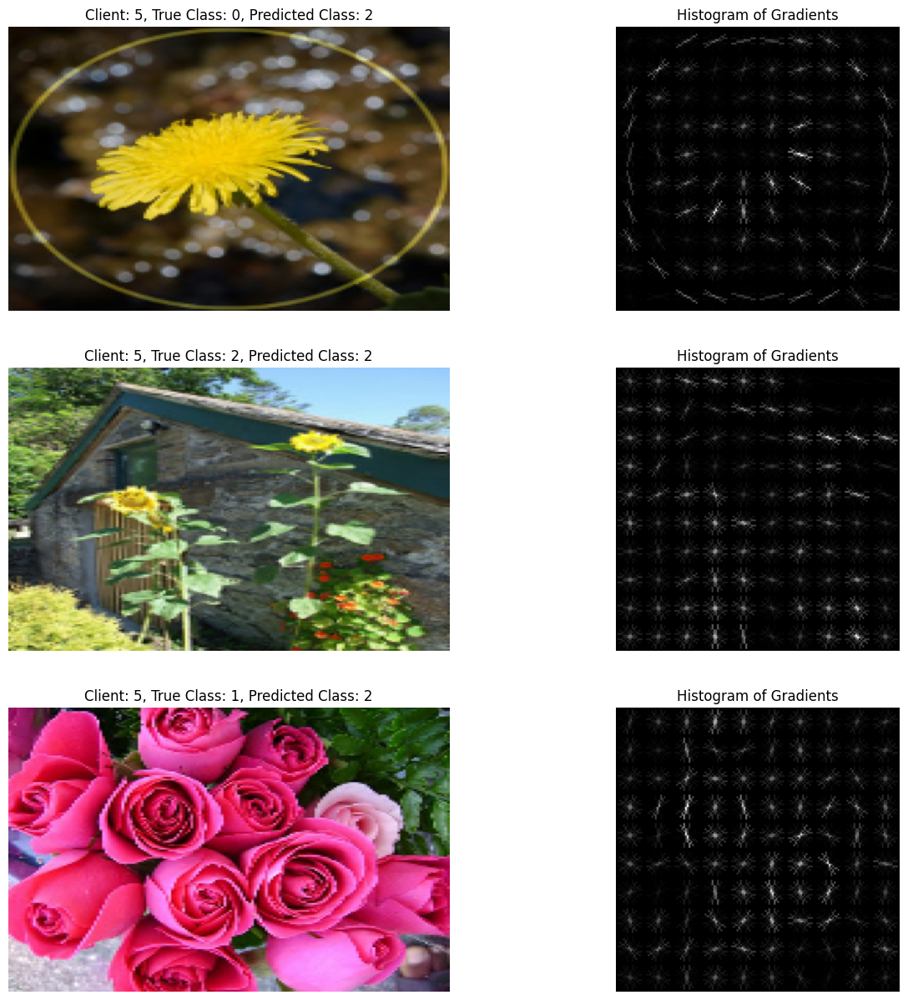

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 426ms/step


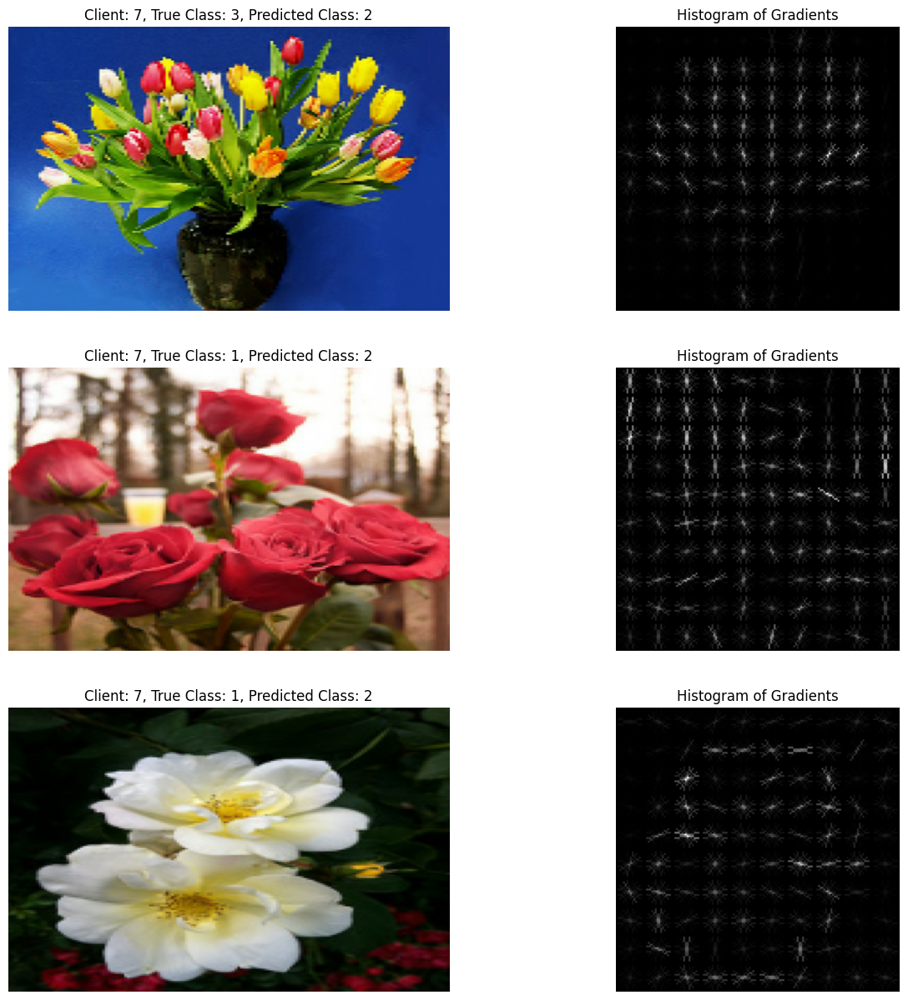

1/1 [==============================] - 0s 428ms/step


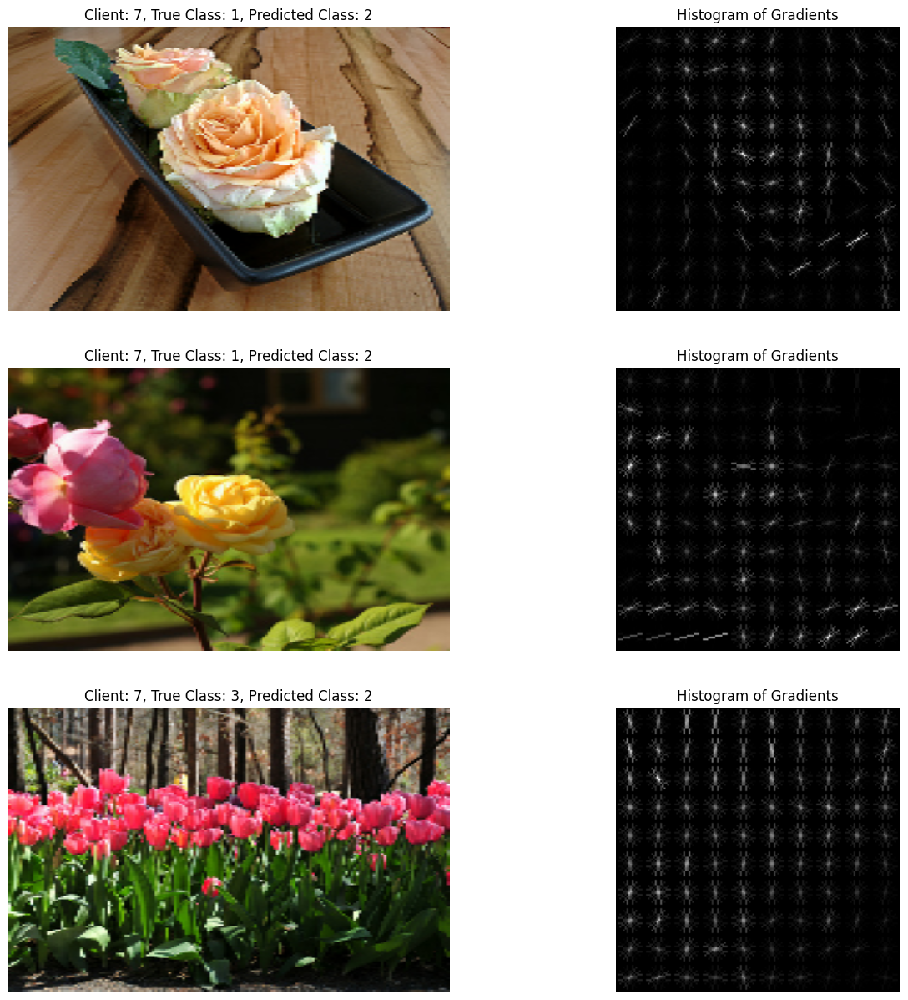

1/1 [==============================] - 0s 448ms/step


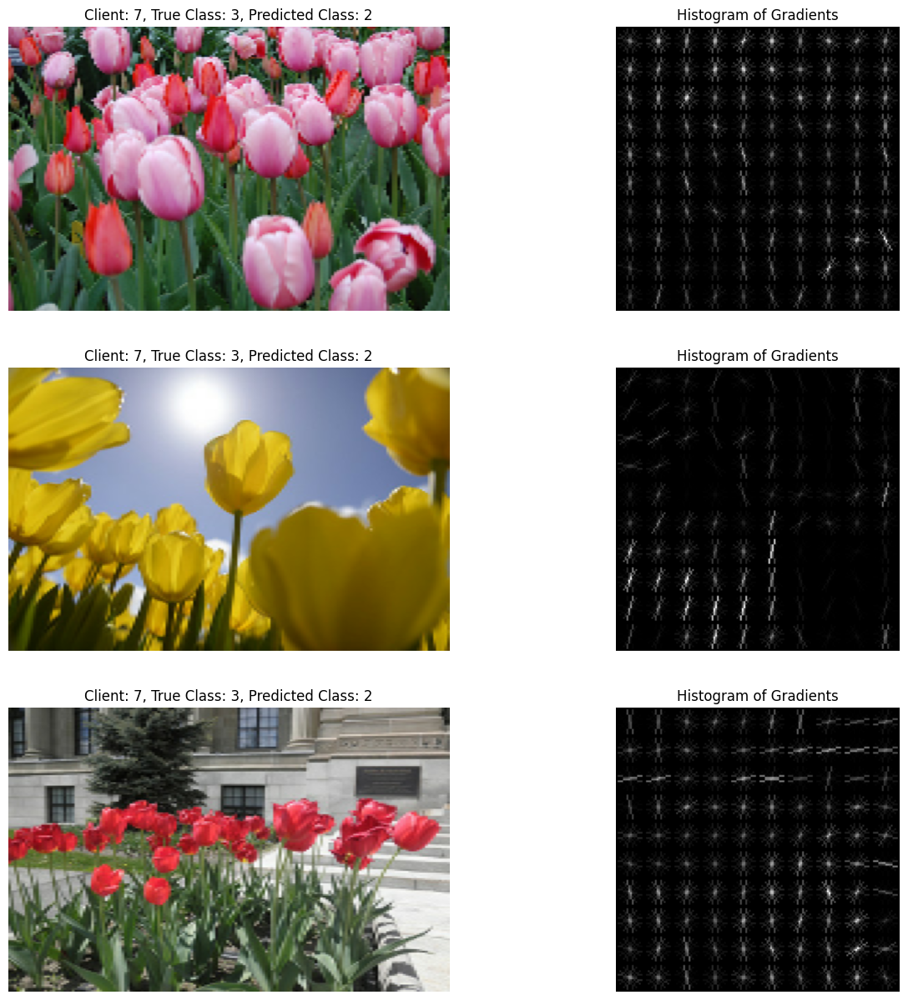

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 433ms/step


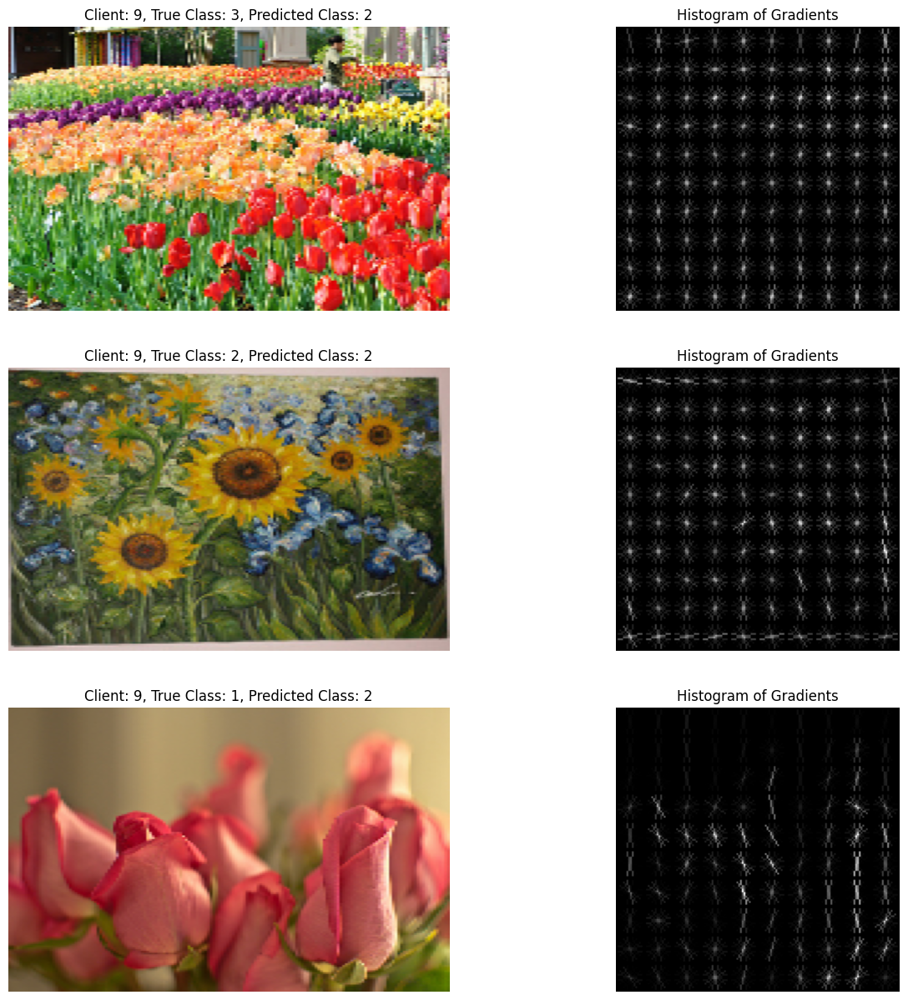

1/1 [==============================] - 0s 498ms/step


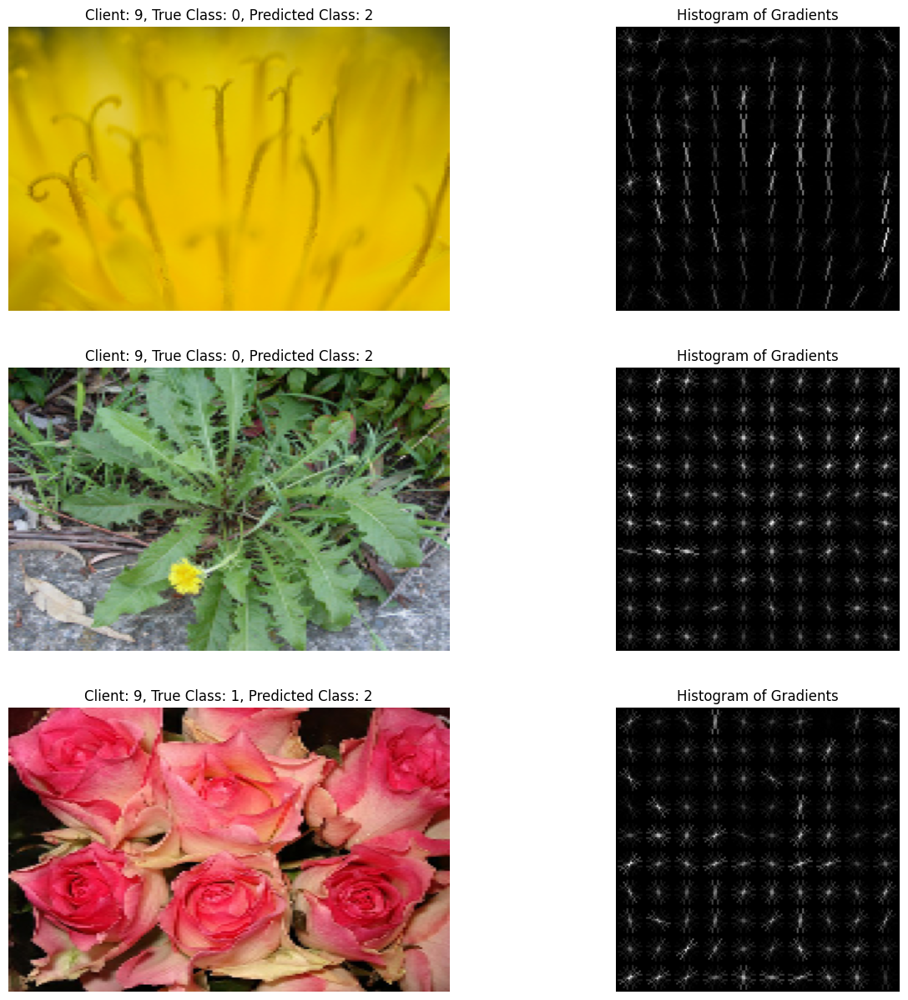

1/1 [==============================] - 0s 386ms/step


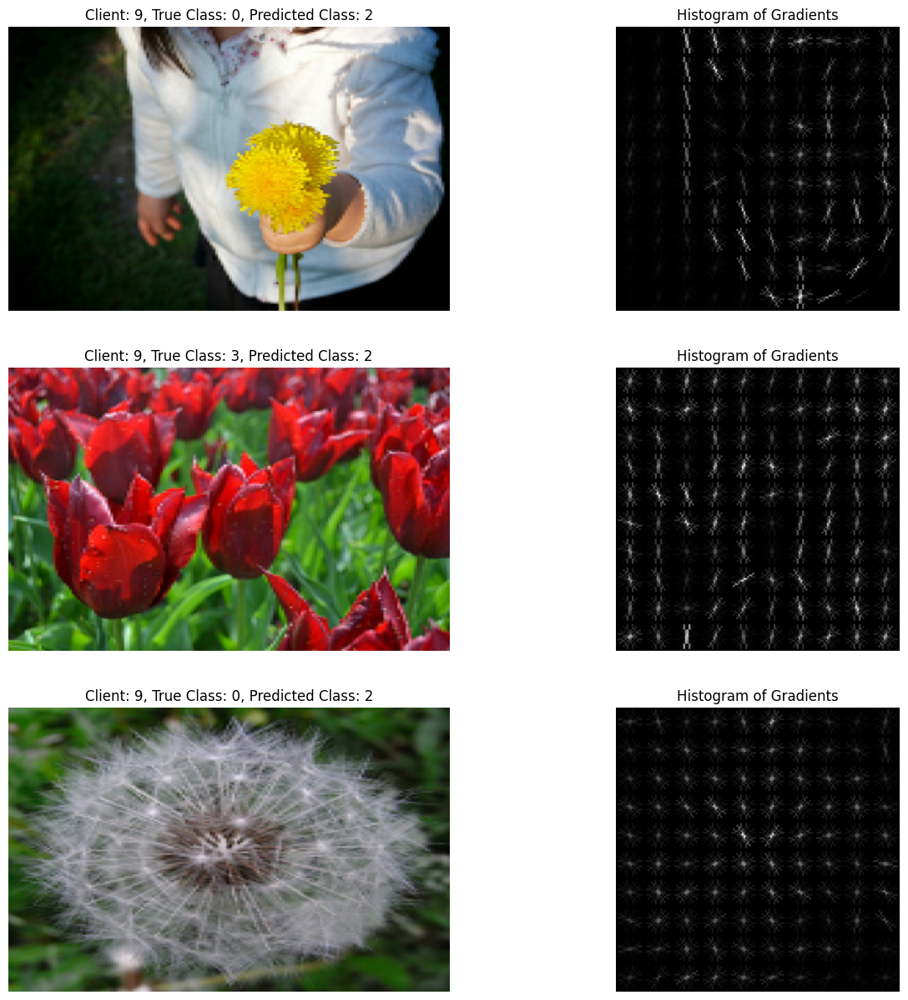

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 206ms/step


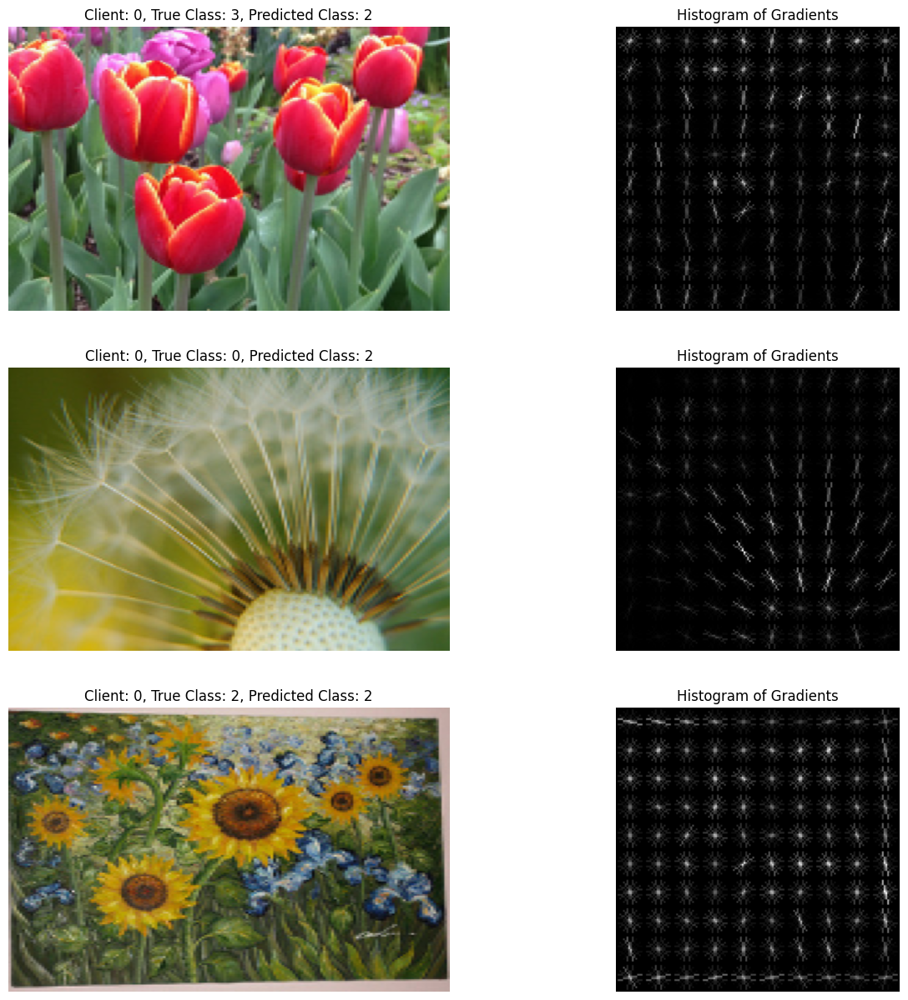

1/1 [==============================] - 0s 338ms/step


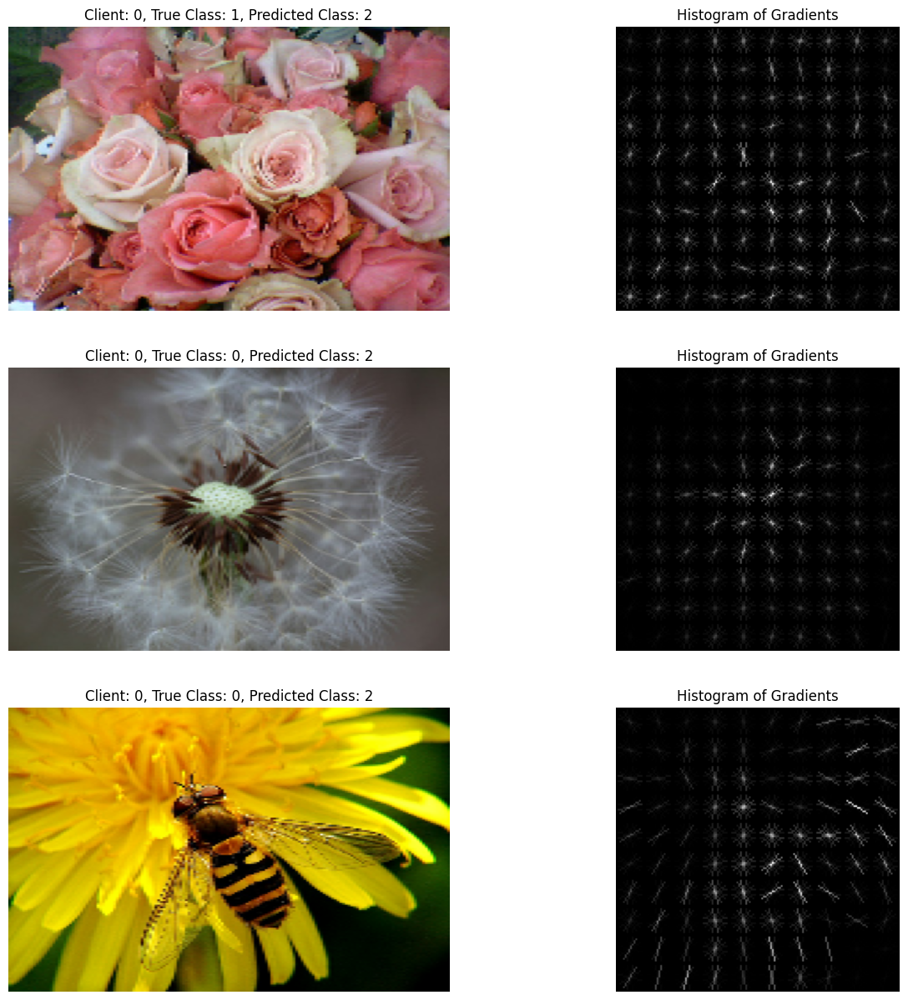

1/1 [==============================] - 0s 388ms/step


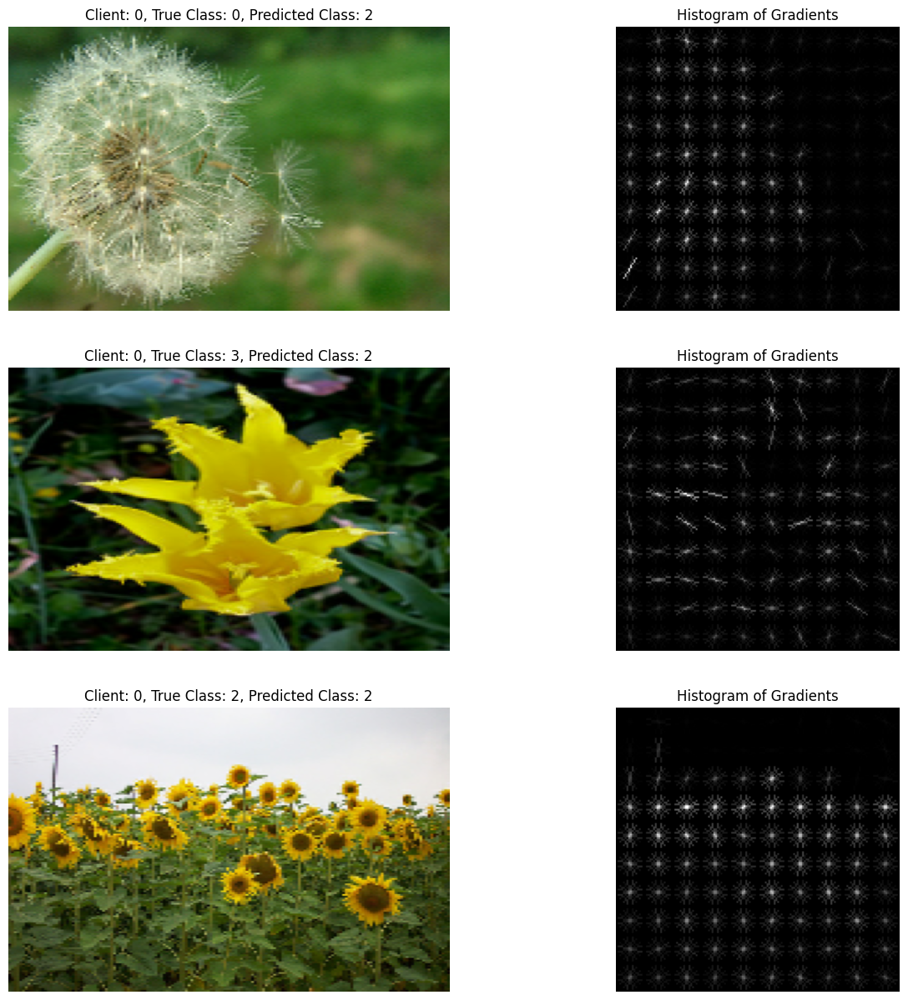

Found 480 files belonging to 4 classes.
Using 96 files for training.
1/1 [==============================] - 0s 435ms/step


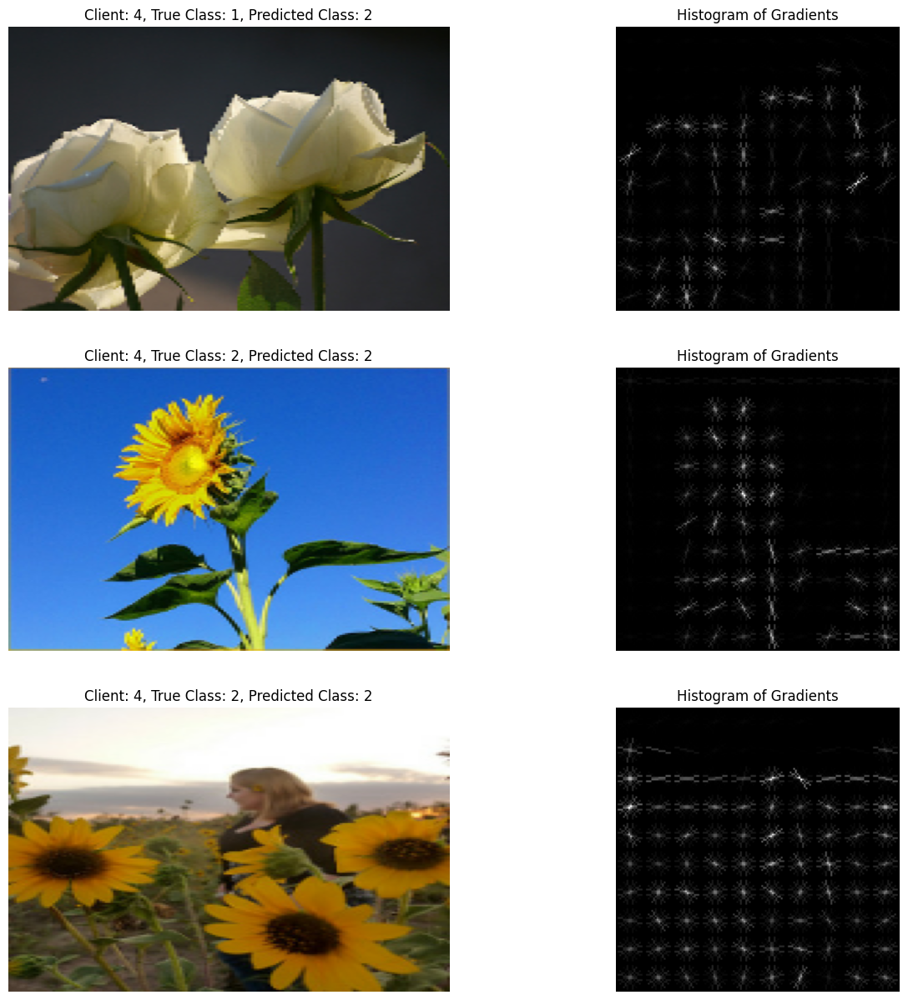

1/1 [==============================] - 0s 415ms/step


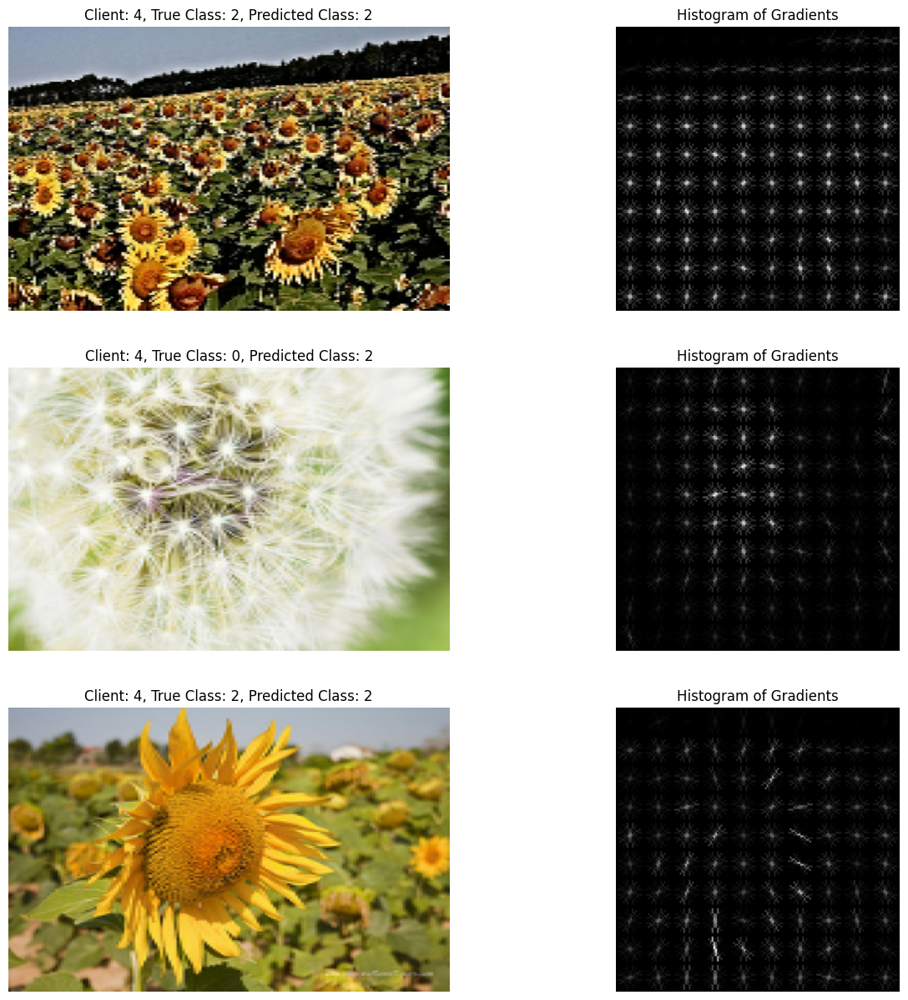

1/1 [==============================] - 0s 387ms/step


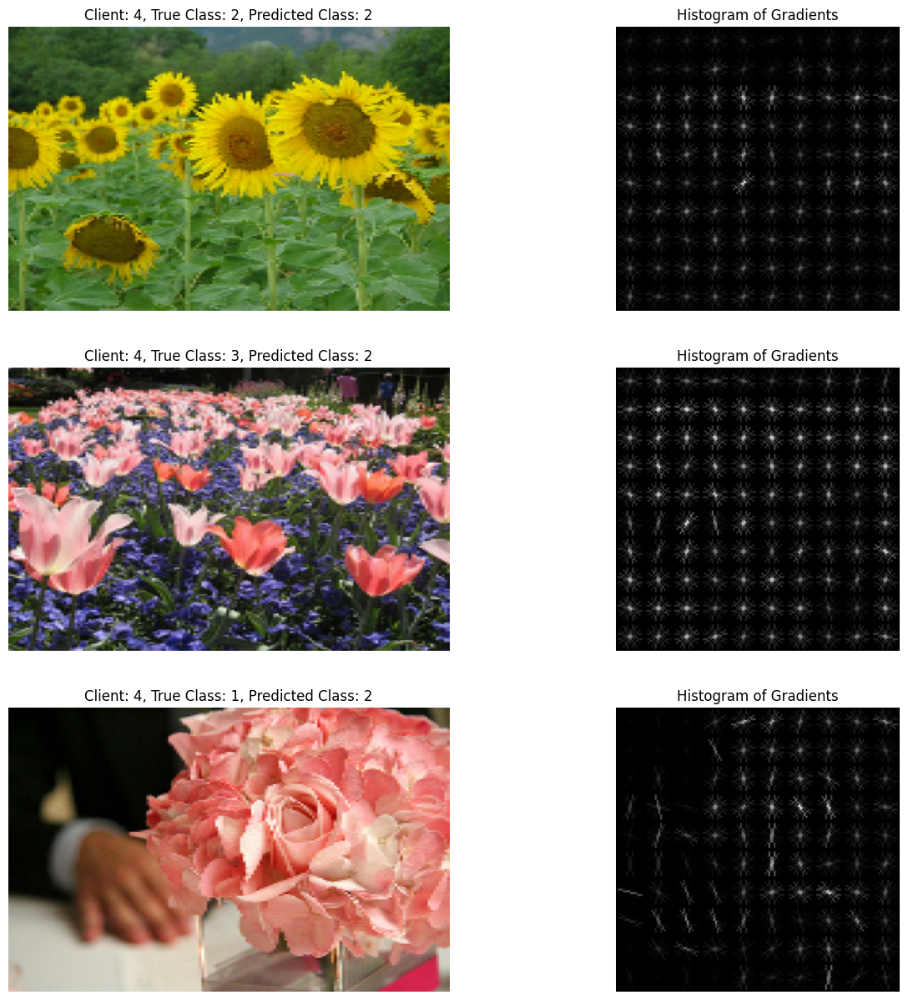

In [ ]:
import random
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure

# ... (previous code remains unchanged)

# Iterate through the selected client IDs
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)
    true_labels_per_client[client_id] = []
    predicted_labels_per_client[client_id] = []

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = loaded_model.predict(images)
        predicted_labels_per_client[client_id].extend(np.argmax(predictions, axis=1))
        true_labels_per_client[client_id].extend(labels)

# Display a few images along with true and predicted labels, and Histogram of Gradients
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = loaded_model.predict(images)
        predicted_labels = np.argmax(predictions, axis=1)

        num_images_to_display = min(3, len(images))
        plt.figure(figsize=(15, 5 * num_images_to_display))  # Adjust the figure size as needed

        for i in range(num_images_to_display):
            plt.subplot(num_images_to_display, 2, 2 * i + 1)
            image = images[i].numpy() / 255.0
            plt.imshow(image, aspect='auto')  # Maintain aspect ratio
            true_label = labels[i].numpy()
            predicted_label = predicted_labels[i]
            plt.title(f'Client: {client_id}, True Class: {true_label}, Predicted Class: {predicted_label}')
            plt.axis('off')

            # Calculate and plot Histogram of Gradients (HOG)
            image_gray = tf.image.rgb_to_grayscale(image).numpy().squeeze()
            fd, hog_image = hog(image_gray, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True)

            plt.subplot(num_images_to_display, 2, 2 * i + 2)
            hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
            plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
            plt.title('Histogram of Gradients')
            plt.axis('off')

        plt.show()


In [ ]:
import random
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# Iterate through the selected client IDs
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)
    true_labels_per_client[client_id] = []
    predicted_labels_per_client[client_id] = []

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = loaded_model.predict(images)
        predicted_labels_per_client[client_id].extend(np.argmax(predictions, axis=1))
        true_labels_per_client[client_id].extend(labels)

# Display a few images along with true and predicted labels
for client_id in random_client_ids:
    client_dataset = create_client_dataset_fn(client_id)

    for batch in client_dataset:
        images, labels = batch['x'], batch['y']
        predictions = loaded_model.predict(images)
        predicted_labels = np.argmax(predictions, axis=1)

        for i in range(min(3, len(images))):  # Display only 3 images for brevity
            plt.figure()
            image = images[i].numpy() / 255.0
            plt.imshow(image, aspect='auto')  # Maintain aspect ratio
            true_label = labels[i].numpy()
            predicted_label = predicted_labels[i]
            plt.title(f'Client: {client_id}, True Class: {true_label}, Predicted Class: {predicted_label}')
            plt.axis('off')
            plt.show()
